## 準備

In [1]:
import sys
sys.path.append("../")
from src.metrics import calculate_evaluation_metrics
import numpy as np
import matplotlib.pyplot as plt
from lib.doa import detect_peaks
import glob
import json
import pyroomacoustics as pra

In [2]:
def compute_spatial_spectrum(noise_subspace):
    num_freq = 102
    spatial_spectrum = np.zeros((num_freq, 360))
    steering_vector = compute_steering_vector()
    for f in range(num_freq):
        steering_vector_f = steering_vector[f, :, :]
        noise_subspace_f = noise_subspace[f, :, :]
        # calculate the MUSIC spectrum for each angle and frequency bin
        vector_norm_squared = np.abs(np.sum(np.conj(steering_vector_f) * steering_vector_f, axis=1))
        noise_projection = np.abs(np.sum(
            np.conj(steering_vector_f) @ noise_subspace_f * (noise_subspace_f.conj().T @ steering_vector_f.T).T,
            axis=1))
        spatial_spectrum[f, :] = vector_norm_squared / noise_projection
    return spatial_spectrum.T


def compute_steering_vector(angle_step=1):
    L = get_mic_positions()
    n_channels = L.shape[1]
    theta = np.deg2rad(np.arange(-180, 180, angle_step))

    direction_vectors = np.zeros((2, len(theta)), dtype=float)
    direction_vectors[0, :] = np.cos(theta)
    direction_vectors[1, :] = np.sin(theta)

    start_freq = 312.5
    end_freq = 3468.75
    step = 31.25
    freq_hz = np.arange(start_freq, end_freq + step, step)

    steering_phase = np.einsum(
        "k,ism,ism->ksm",
        2.0j * np.pi / 343.0 * freq_hz,
        direction_vectors[..., None],
        L[:, None, :]
    )
    steering_vector = 1.0 / np.sqrt(n_channels) * np.exp(steering_phase)
    return steering_vector


def get_mic_positions():
    center = (0, 0)
    radius = 0.2

    mic_positions = pra.circular_2D_array(center=center, M=8, phi0=0, radius=radius)
    # 上側のマイクロホンを削除
    mic_positions = np.delete(mic_positions, np.where(mic_positions[1] > center[1] + 0.01), axis=1)
    # 新しい座標を既存の配列に追加
    new_points = np.array([
        [center[0] - radius / 2, center[1]],
        center,
        [center[0] + radius / 2, center[1]],
        [center[0], center[1] - radius / 2],
    ]).T
    mic_positions = np.concatenate((mic_positions, new_points), axis=1)
    return mic_positions

In [9]:
def compare_spectra(dir_ref, method, decomposed_coeff, thresh):
    decomposed_values = np.load(f"{dir_ref}/{method}/decomposed_values.npy")
    decomposed_vectors = np.load(f"{dir_ref}/{method}/decomposed_vectors.npy")

    max_value = np.max(decomposed_values, axis=1)

    spectra_recompute = []
    for i in range(max_value.shape[0]):
        decomposed_thresh = np.min(max_value[i, :]) * decomposed_coeff
        # threshより大きい値の個数
        num = np.sum(max_value[i, :] > decomposed_thresh)
        spatial_spectrum = compute_spatial_spectrum(decomposed_vectors[i, :, :, :-num])
        num_freq = 102
        spectra_recompute.append(np.squeeze(np.sum(spatial_spectrum, axis=1) / num_freq))

    spectra_recompute = np.array(spectra_recompute)

    spectra_file_path = f"{dir_ref}/{method}/spectra.npy"
    spectra_loaded = np.load(spectra_file_path)

    # Load the answer file and convert radian angles to data point indices
    ans_file_path = f"{dir_ref}/simulation/ans.json"
    with open(ans_file_path, "r") as f:
        ans_json = json.load(f)

    ans_voice = np.array(ans_json["voice"])
    ans_ambient = np.array(ans_json["ambient"]) if "ambient" in ans_json else []

    # Collecting radians from the answer
    ans_radians = []
    for key in ans_json.keys():
        ans_radians += ans_json[key]

    # Convert radians to indices function
    def radians_to_indices(radians, total_points):
        degrees = [(180 / np.pi) * (rad + np.pi) for rad in radians]
        indices = [int(total_points * (deg / 180)) for deg in degrees]
        return indices

    # Convert radians to indices
    ans_indices = radians_to_indices(ans_radians, 180)

    TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

    fig, axs = plt.subplots(1, 2, figsize=(15, 4))
    for j, spectra in enumerate([spectra_loaded, spectra_recompute]):
        for spectrum in spectra:
            axs[j].plot(spectrum[:180])
            idx = detect_peaks(spectrum[:180], mph=thresh)
            axs[j].scatter(idx, [spectrum[i] for i in idx], c="r", s=50)

            if j == 1:
                # Calculate the evaluation metrics
                d_theta = np.pi / 180
                _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = \
                    calculate_evaluation_metrics(ans_voice, ans_ambient, - np.pi + idx * d_theta, 3)
                TP_voice += _TP_voice
                FN_voice += _FN_voice
                if len(ans_ambient) > 0:
                    TP_ambient += _TP_ambient
                    FN_ambient += _FN_ambient
                FP += _FP

        for ans_idx in ans_indices:
            axs[j].axvline(x=ans_idx, color="blue", linestyle="--")

        axs[j].set_xlabel("Data Point Index")
        axs[j].set_ylabel("Intensity")

        if j == 0:
            axs[j].set_title("Loaded Spectra")
        else:
            axs[j].set_title("Recomputed Spectra")

    plt.show()
    return TP_voice, FN_voice, TP_ambient, FN_ambient, FP

In [10]:
# dir_ref = "../experiments/2;[0.1, 1.0];hard_surface;1;1;11;0"
# compare_spectra(dir_ref, method="SEVD", decomposed_coeff=2000, thresh=4)

## SEVD

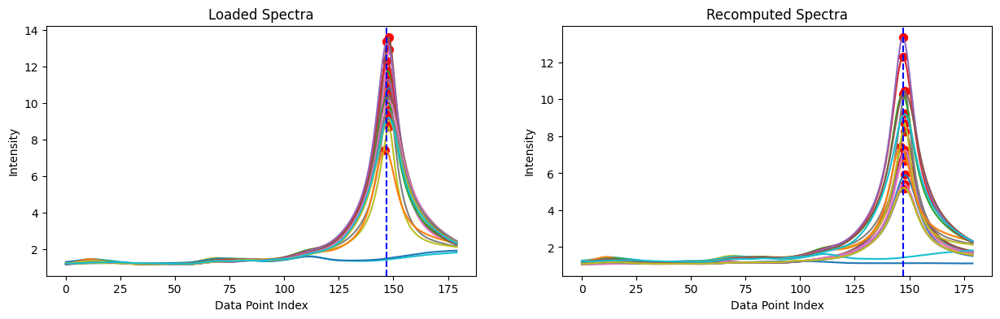

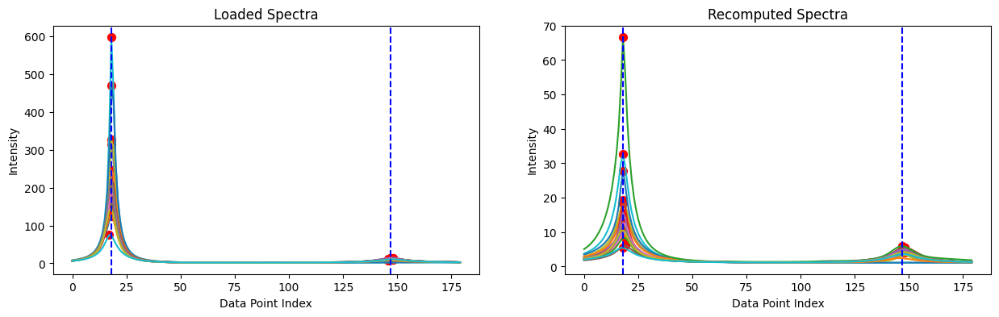

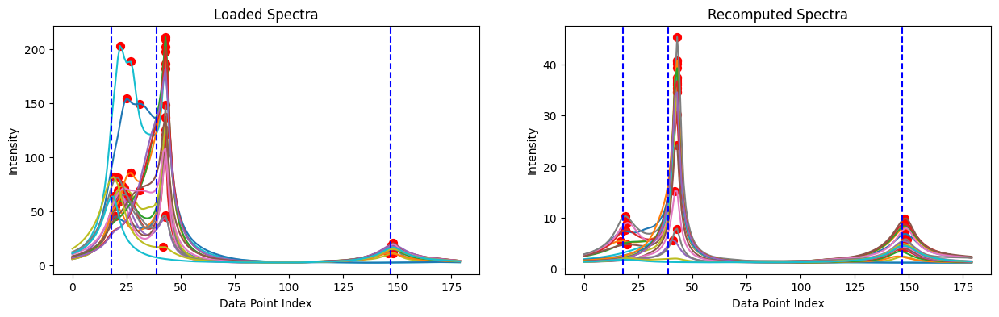

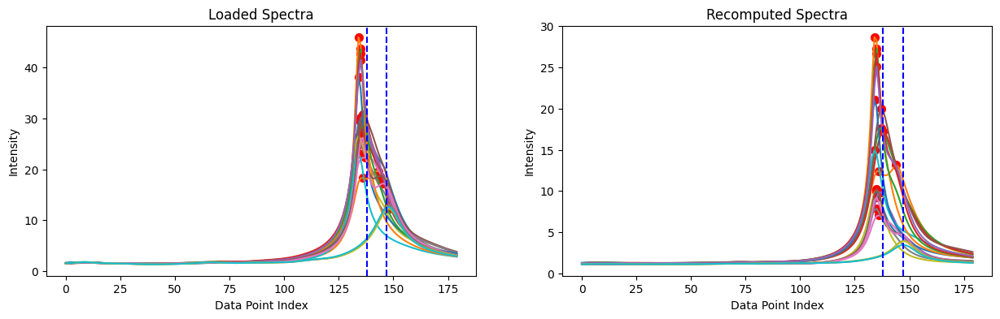

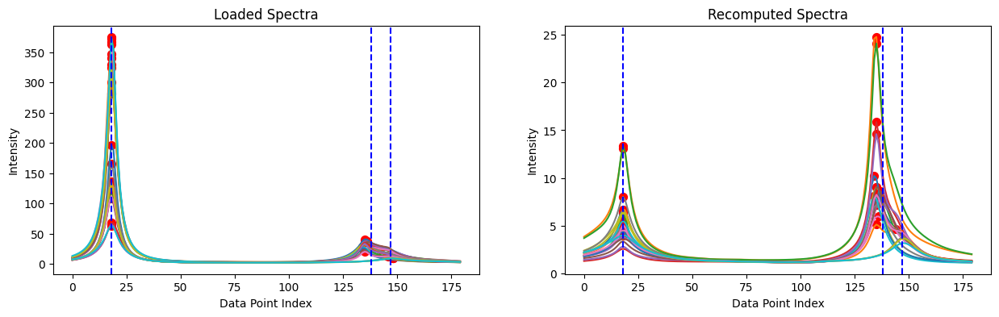

...

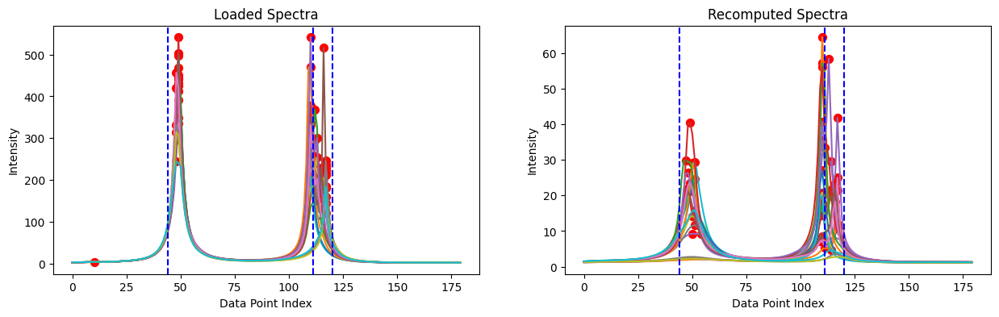

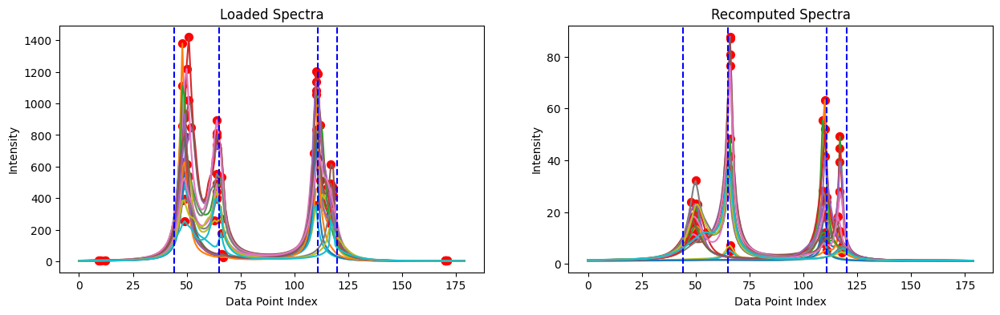

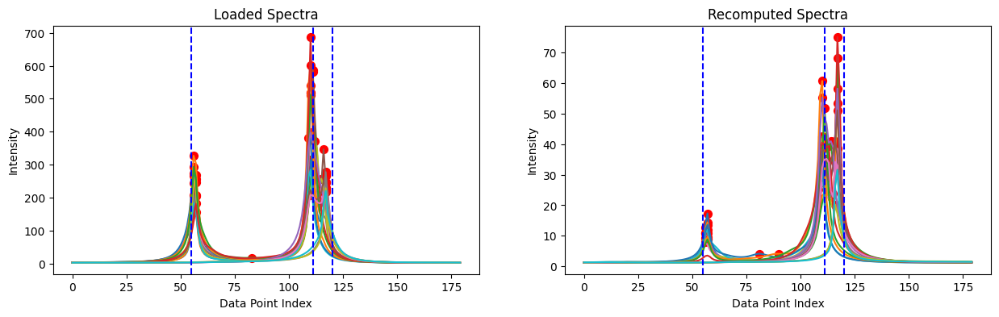

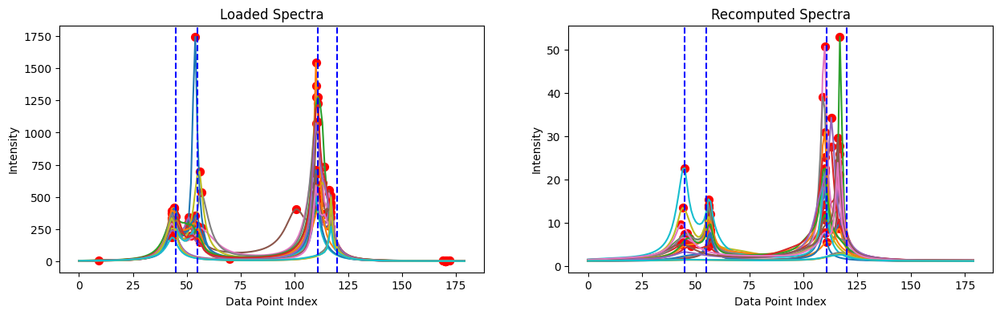

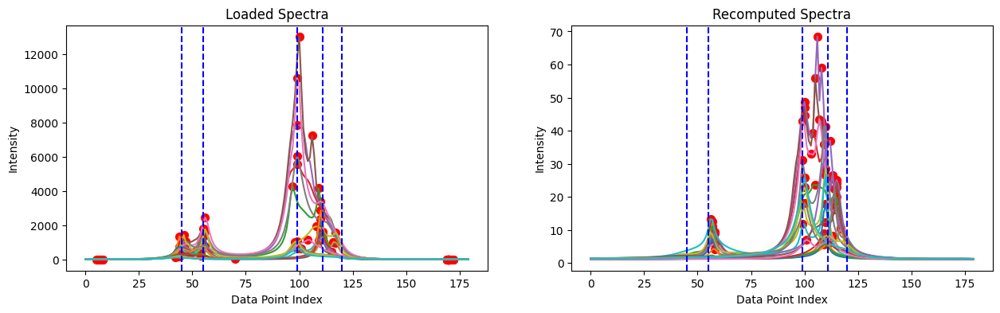

TP_voice: 610, FN_voice: 830, TP_ambient: 204, FN_ambient: 516, FP: 527


In [11]:
TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

for dir_ref in glob.glob("../experiments/*;*"):
    _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = compare_spectra(dir_ref, method="SEVD", decomposed_coeff=2000, thresh=4)
    TP_voice += _TP_voice
    FN_voice += _FN_voice
    TP_ambient += _TP_ambient
    FN_ambient += _FN_ambient
    FP += _FP

print(f"TP_voice: {TP_voice}, FN_voice: {FN_voice}, TP_ambient: {TP_ambient}, FN_ambient: {FN_ambient}, FP: {FP}")

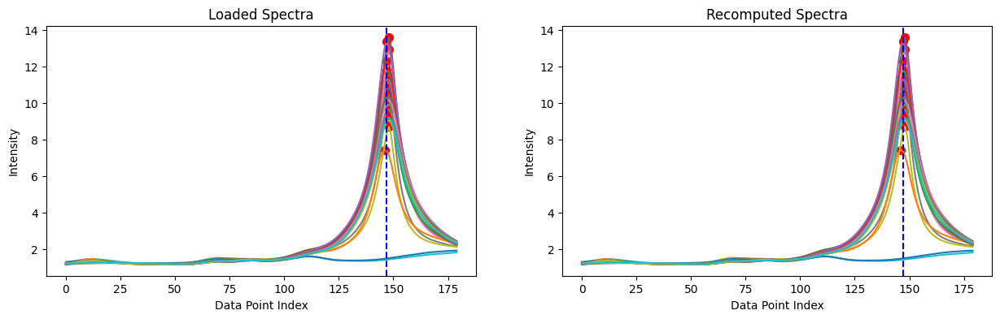

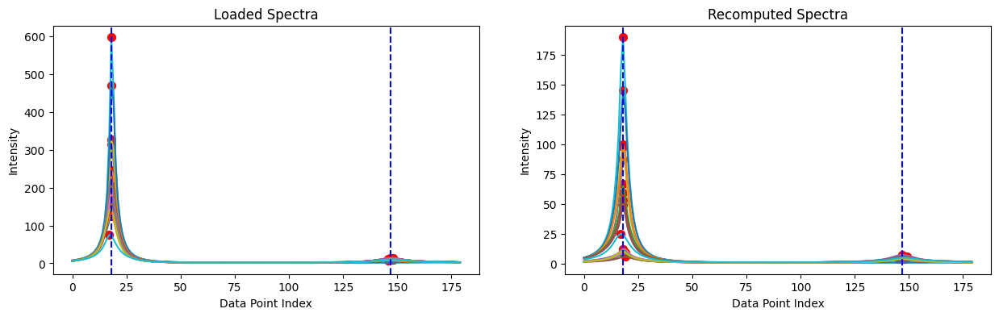

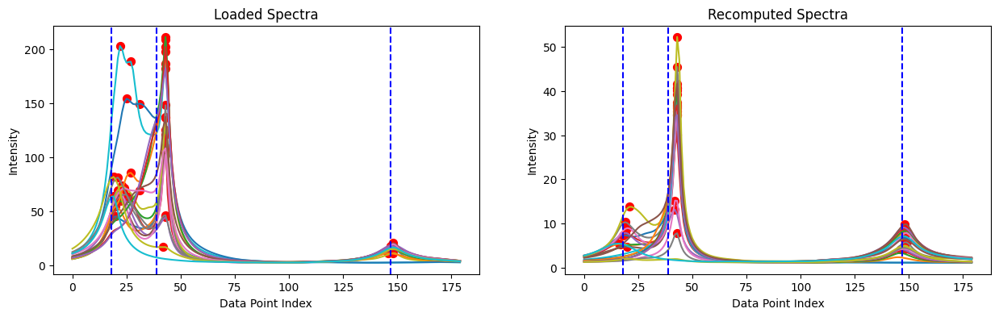

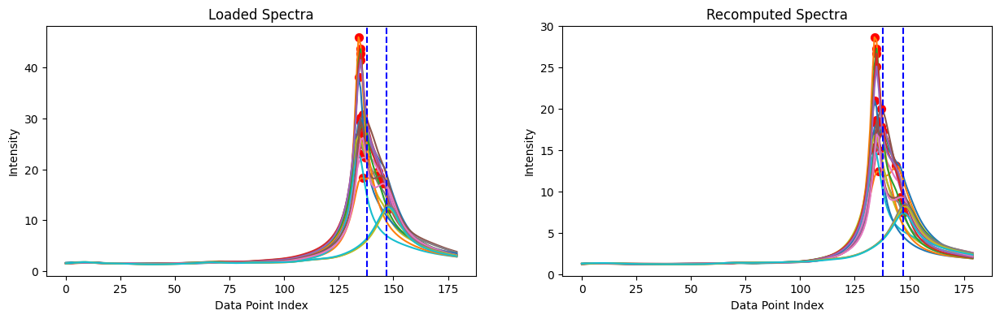

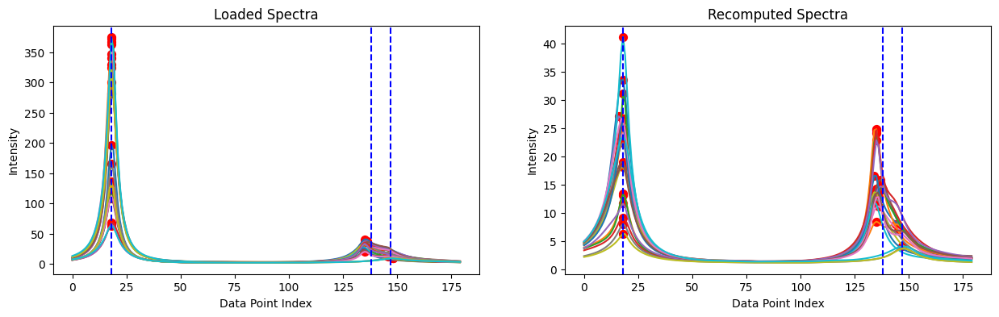

...

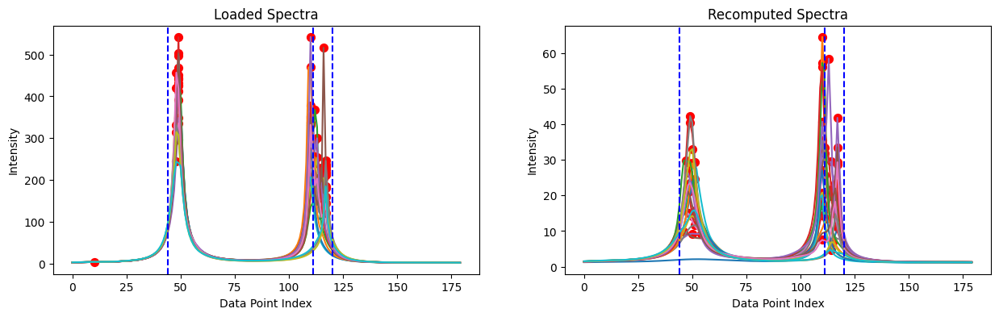

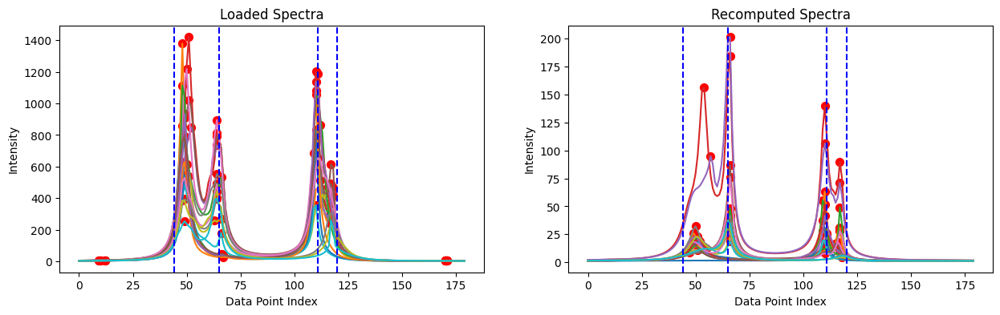

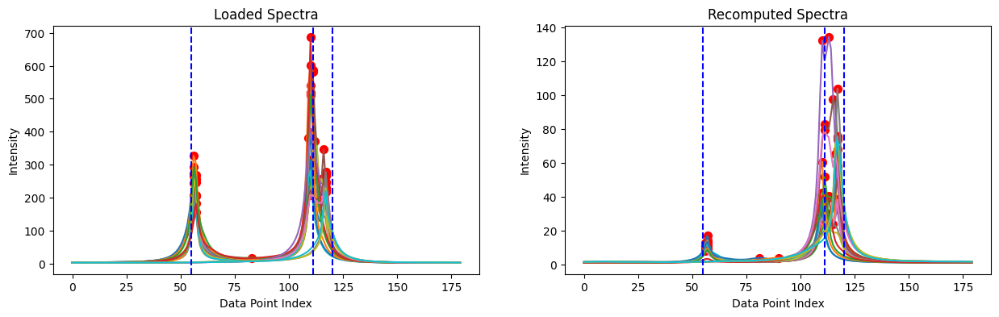

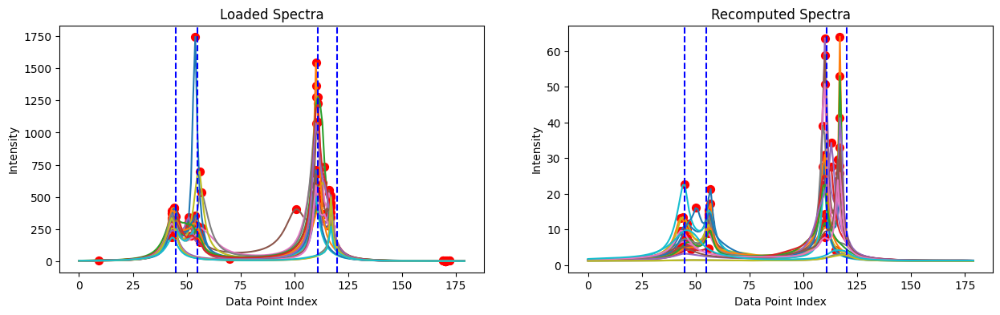

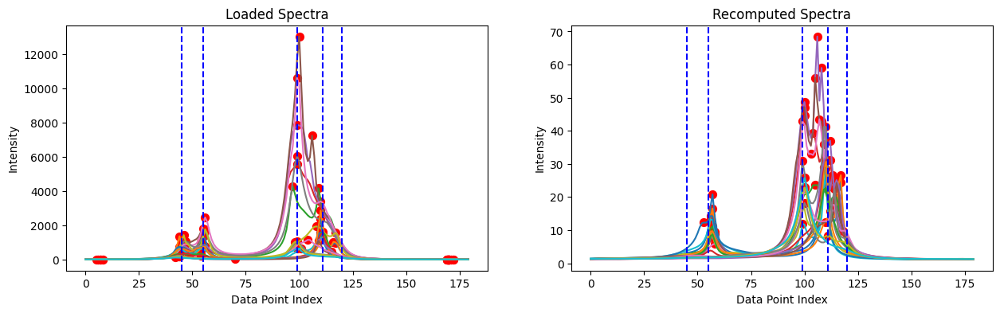

TP_voice: 654, FN_voice: 786, TP_ambient: 228, FN_ambient: 492, FP: 609


In [12]:
TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

for dir_ref in glob.glob("../experiments/*;*"):
    _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = compare_spectra(dir_ref, method="SEVD", decomposed_coeff=1000, thresh=4)
    TP_voice += _TP_voice
    FN_voice += _FN_voice
    TP_ambient += _TP_ambient
    FN_ambient += _FN_ambient
    FP += _FP

print(f"TP_voice: {TP_voice}, FN_voice: {FN_voice}, TP_ambient: {TP_ambient}, FN_ambient: {FN_ambient}, FP: {FP}")

## GEVD incremental

/tmp/ipykernel_8874/1940531814.py:13: RuntimeWarning: divide by zero encountered in divide
  spatial_spectrum[f, :] = vector_norm_squared / noise_projection


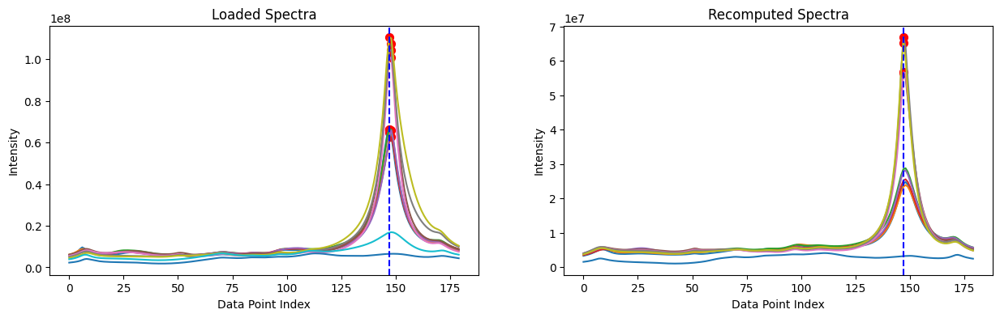

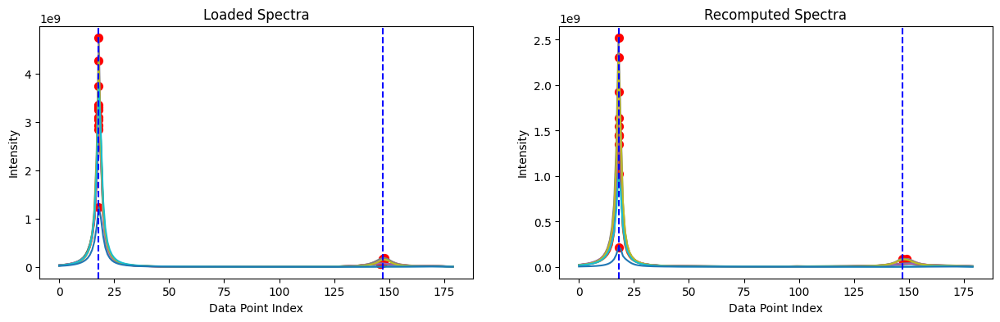

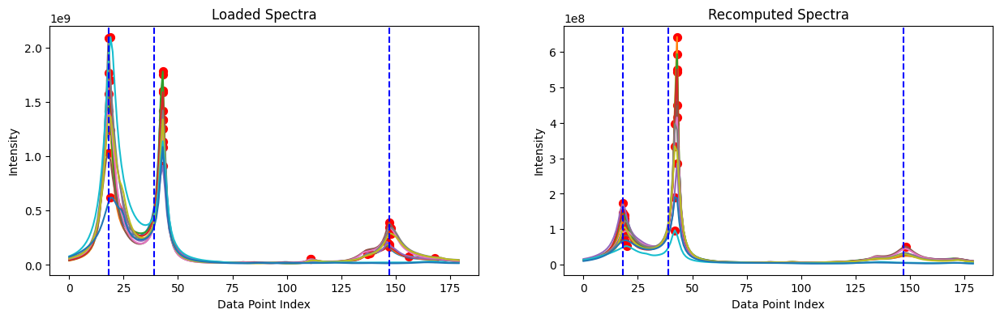

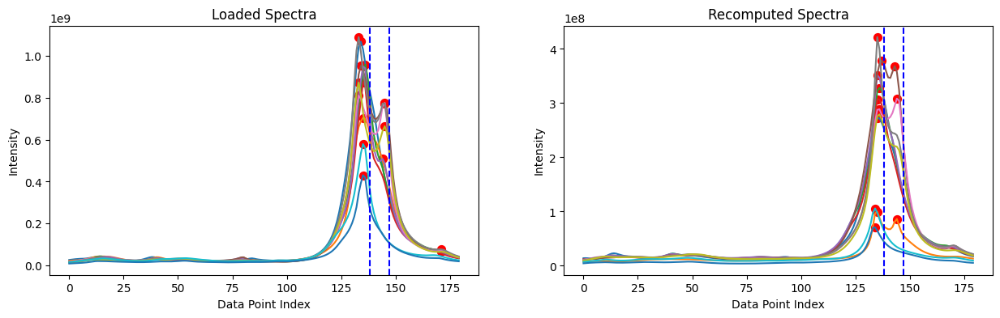

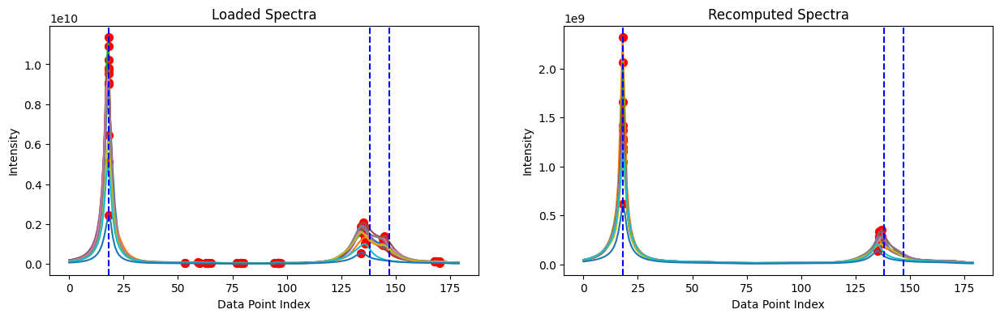

...

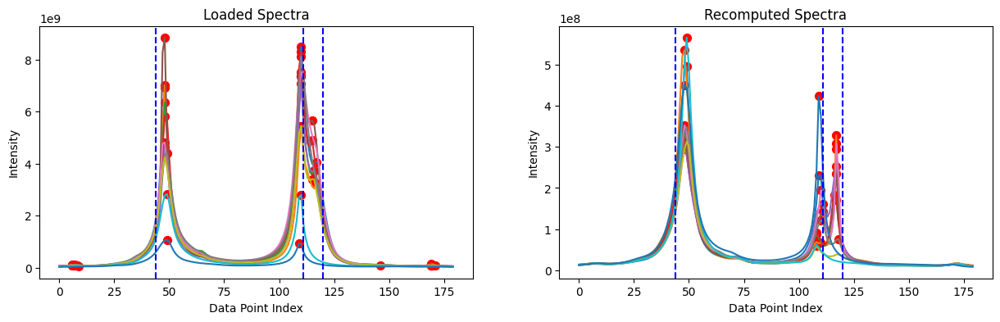

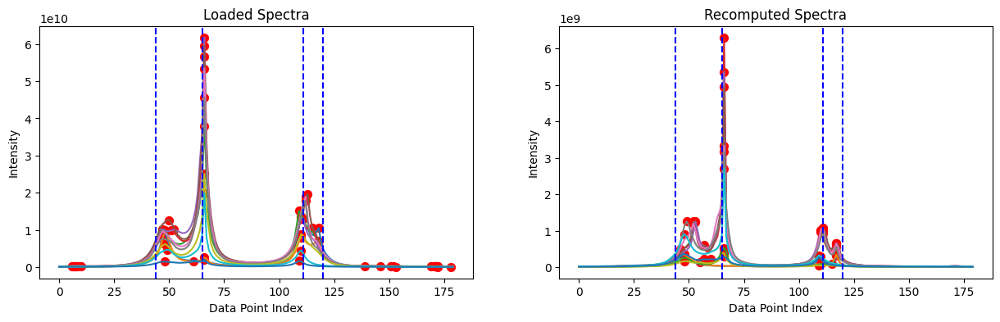

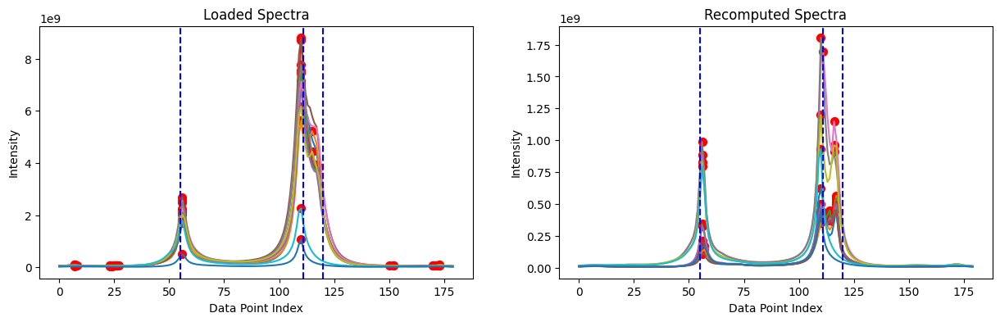

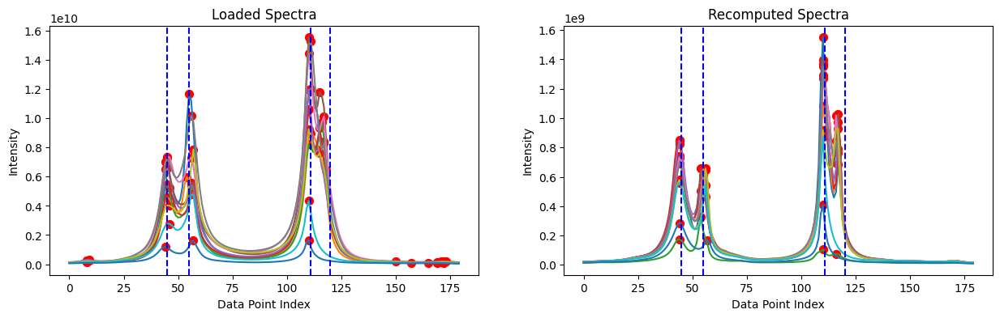

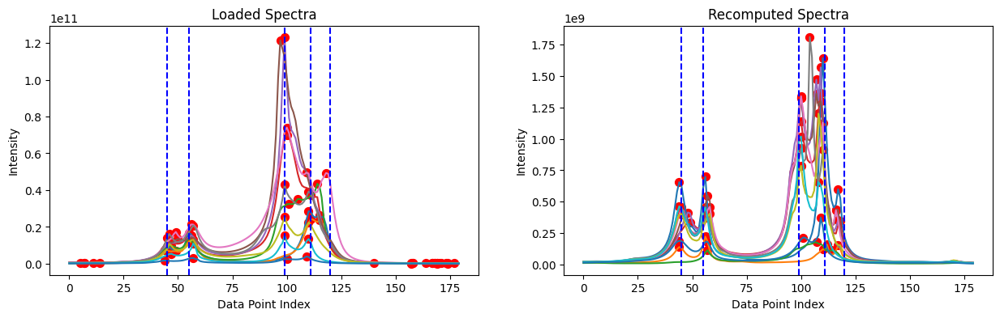

TP_voice: 409, FN_voice: 383, TP_ambient: 218, FN_ambient: 178, FP: 441


In [19]:
TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

for dir_ref in glob.glob("../experiments/*;*"):
    _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = compare_spectra(dir_ref, method="GEVD_incremental", decomposed_coeff=2000, thresh=5 * 10 ** 7)
    TP_voice += _TP_voice
    FN_voice += _FN_voice
    TP_ambient += _TP_ambient
    FN_ambient += _FN_ambient
    FP += _FP

print(f"TP_voice: {TP_voice}, FN_voice: {FN_voice}, TP_ambient: {TP_ambient}, FN_ambient: {FN_ambient}, FP: {FP}")

## GEVD ans dir

/tmp/ipykernel_8874/1940531814.py:13: RuntimeWarning: divide by zero encountered in divide
  spatial_spectrum[f, :] = vector_norm_squared / noise_projection


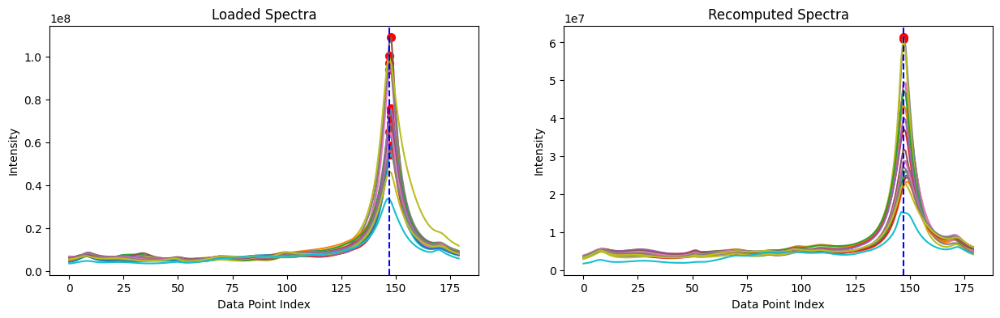

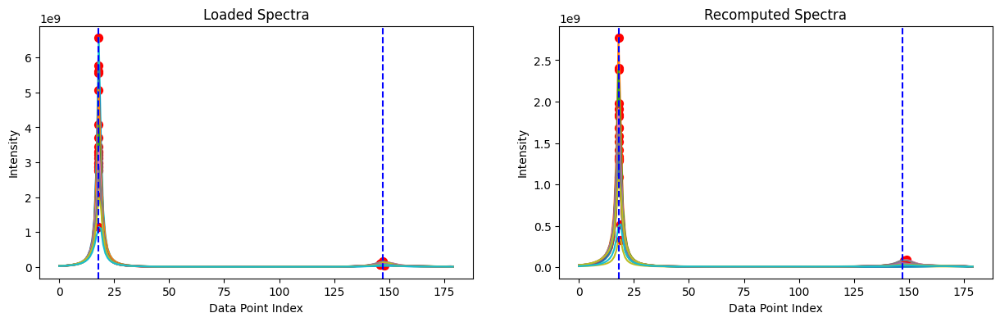

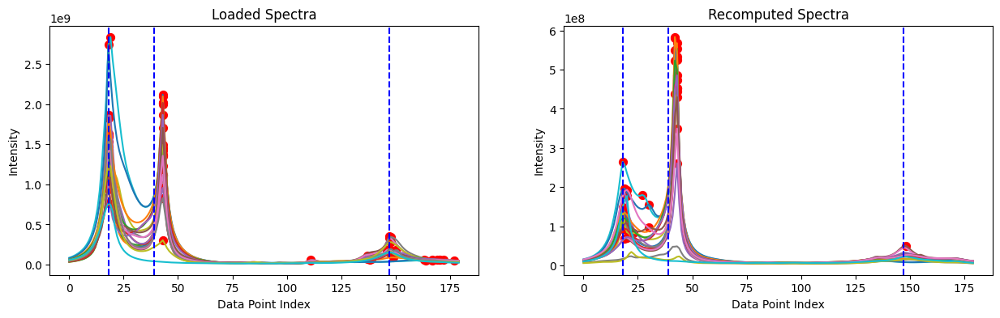

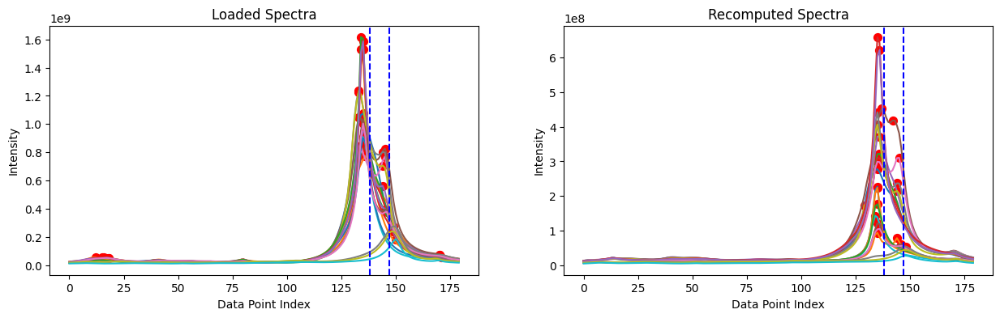

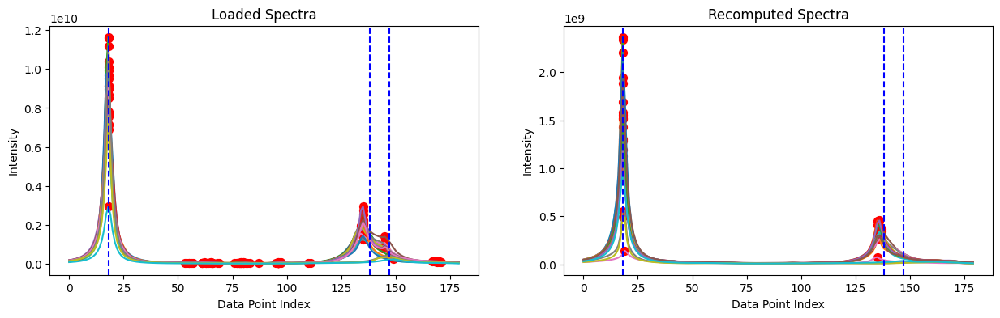

...

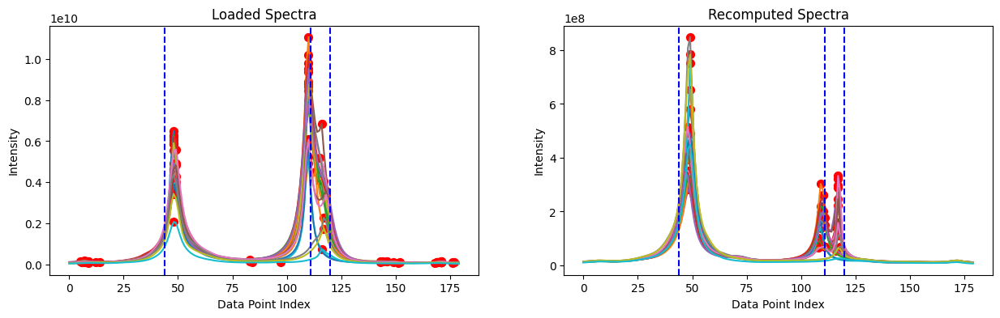

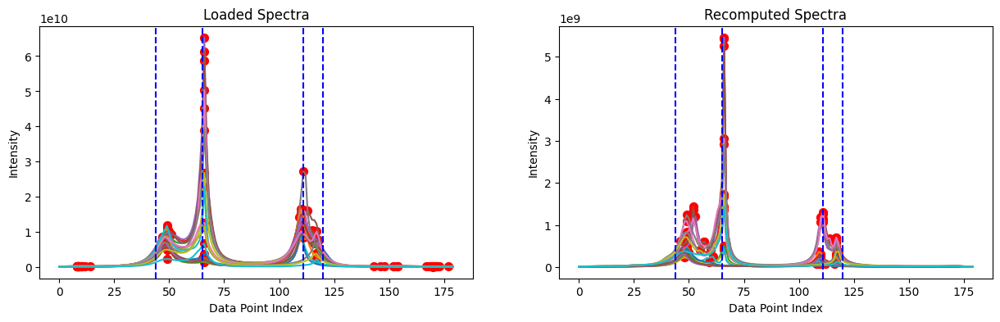

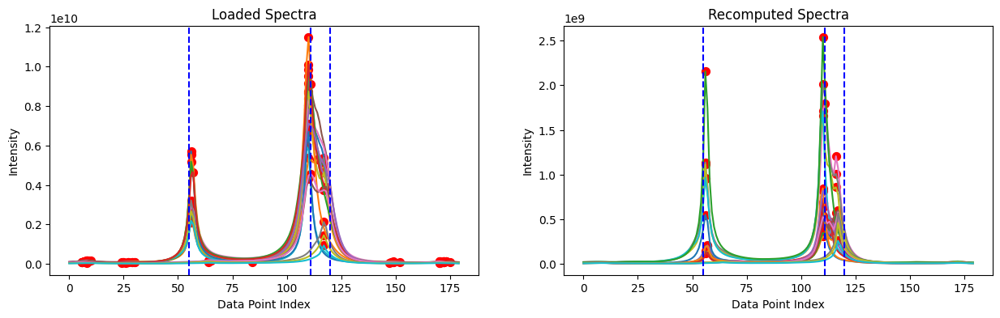

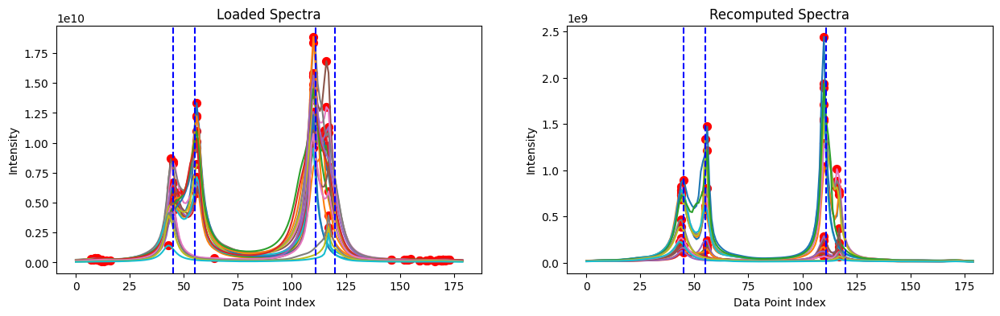

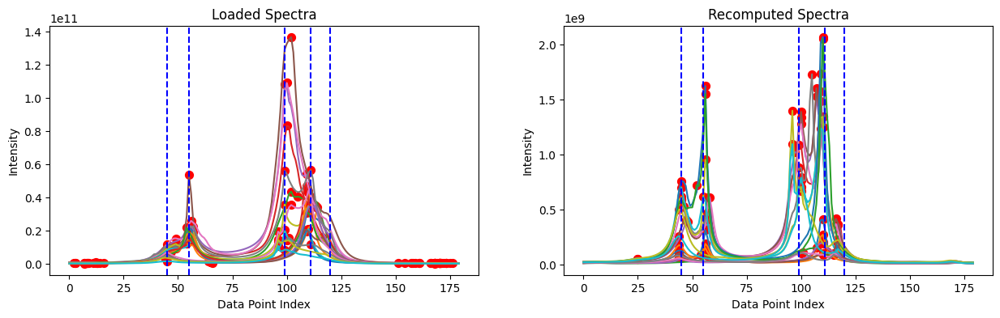

TP_voice: 636, FN_voice: 804, TP_ambient: 352, FN_ambient: 368, FP: 713


In [21]:
TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

for dir_ref in glob.glob("../experiments/*;*"):
    _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = compare_spectra(dir_ref, method="GEVD_ans_dir", decomposed_coeff=2000, thresh=5 * 10 ** 7)
    TP_voice += _TP_voice
    FN_voice += _FN_voice
    TP_ambient += _TP_ambient
    FN_ambient += _FN_ambient
    FP += _FP

print(f"TP_voice: {TP_voice}, FN_voice: {FN_voice}, TP_ambient: {TP_ambient}, FN_ambient: {FN_ambient}, FP: {FP}")

## GEVD ans rev

/tmp/ipykernel_8874/1940531814.py:13: RuntimeWarning: divide by zero encountered in divide
  spatial_spectrum[f, :] = vector_norm_squared / noise_projection


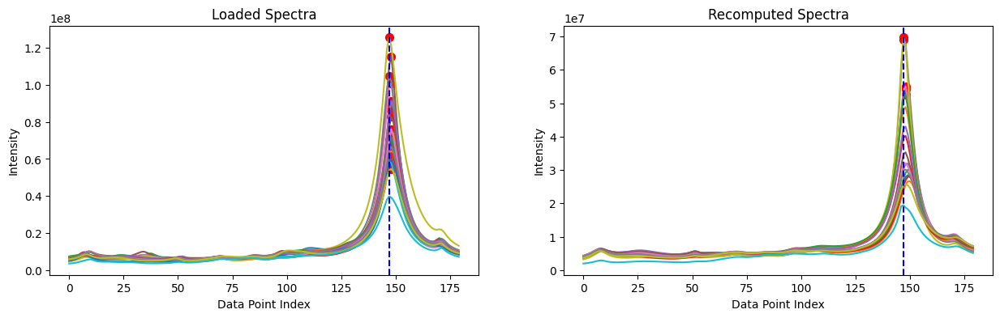

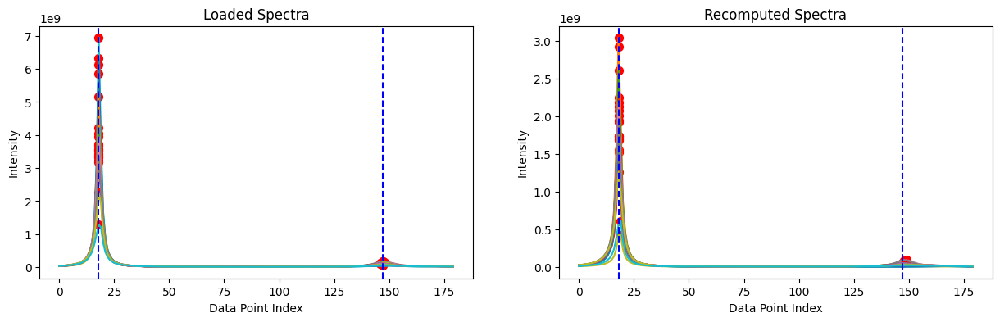

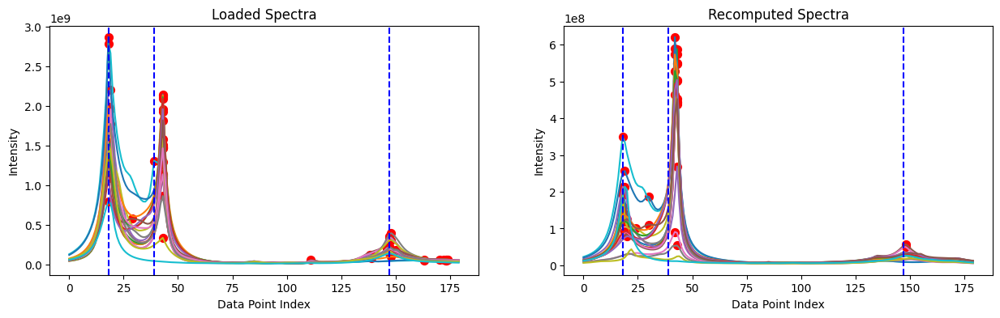

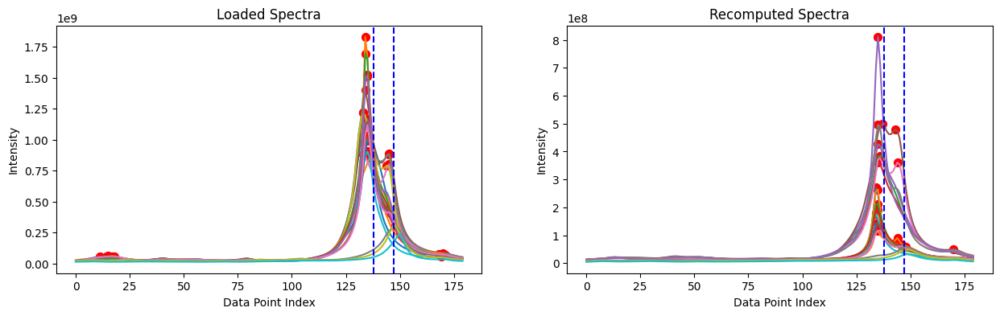

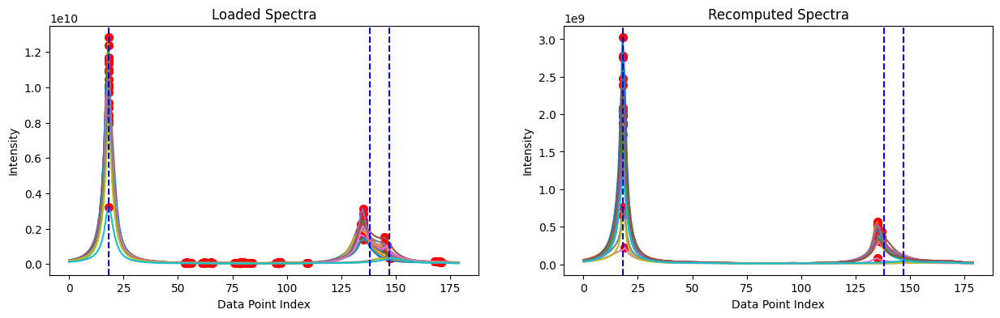

...

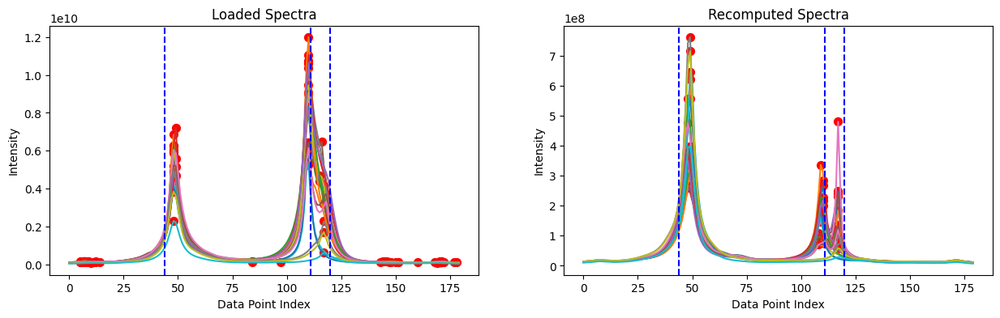

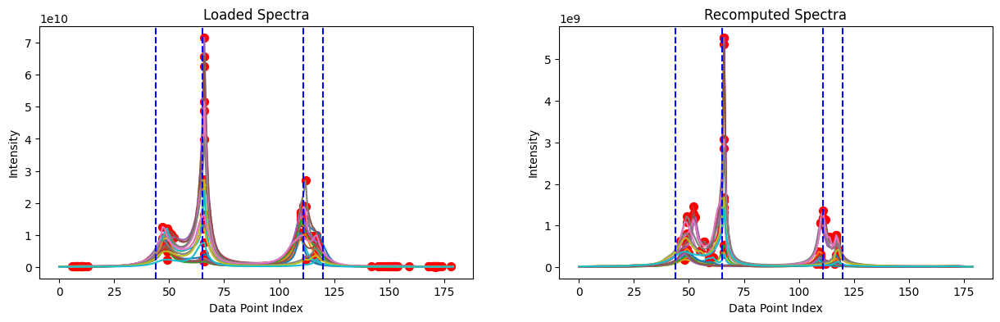

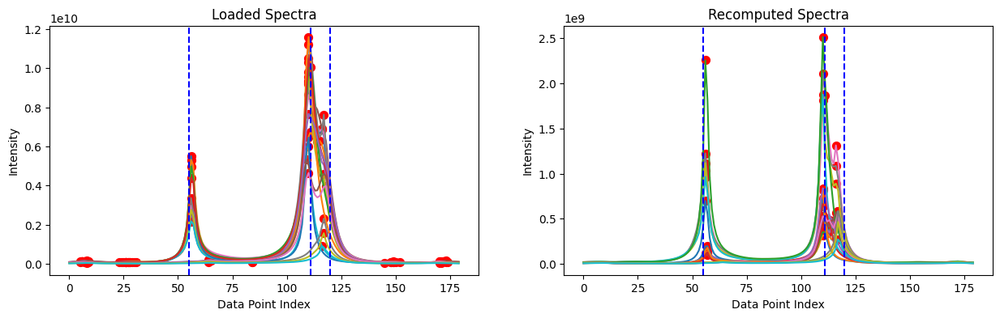

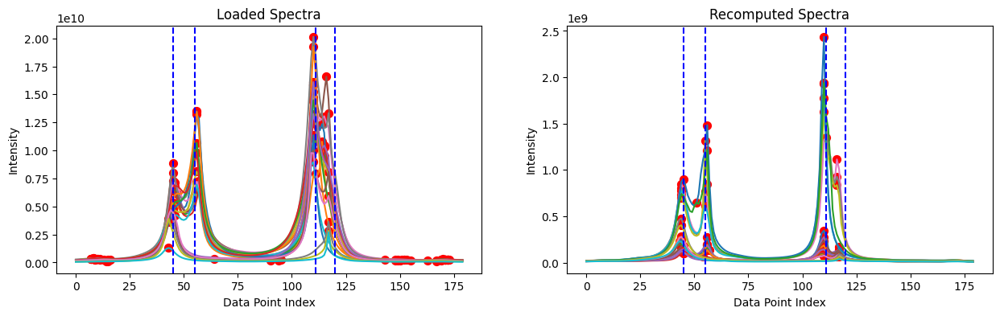

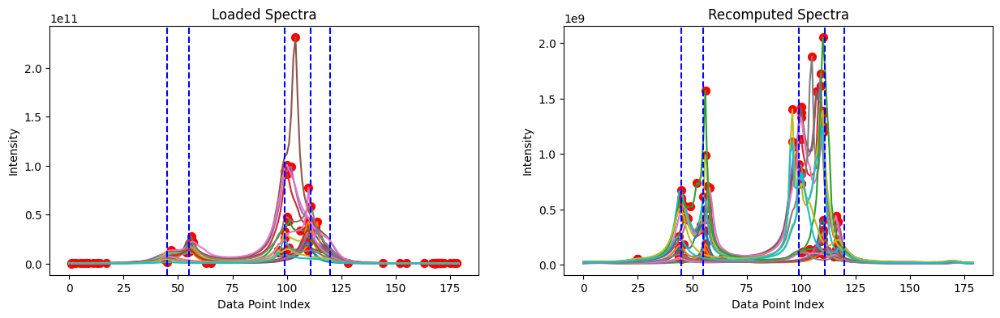

TP_voice: 626, FN_voice: 814, TP_ambient: 337, FN_ambient: 383, FP: 709


In [22]:
TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

for dir_ref in glob.glob("../experiments/*;*"):
    _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = compare_spectra(dir_ref, method="GEVD_ans_rev", decomposed_coeff=2000, thresh=5 * 10 ** 7)
    TP_voice += _TP_voice
    FN_voice += _FN_voice
    TP_ambient += _TP_ambient
    FN_ambient += _FN_ambient
    FP += _FP

print(f"TP_voice: {TP_voice}, FN_voice: {FN_voice}, TP_ambient: {TP_ambient}, FN_ambient: {FN_ambient}, FP: {FP}")

## GEVD diff dir

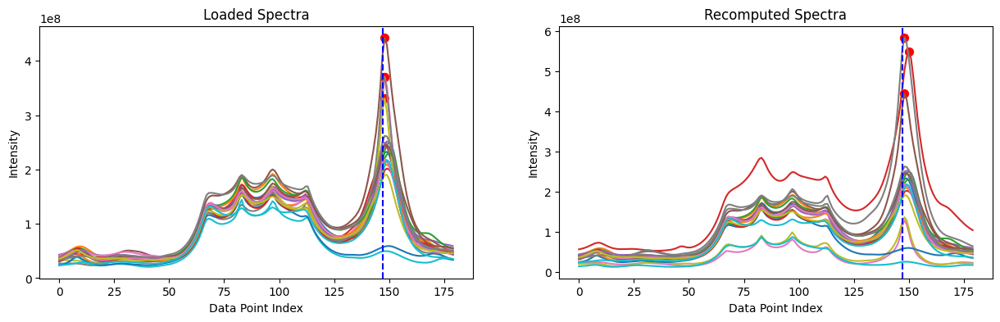

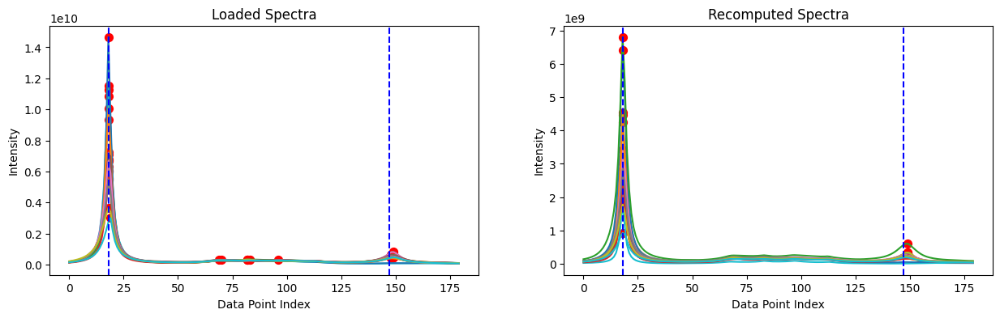

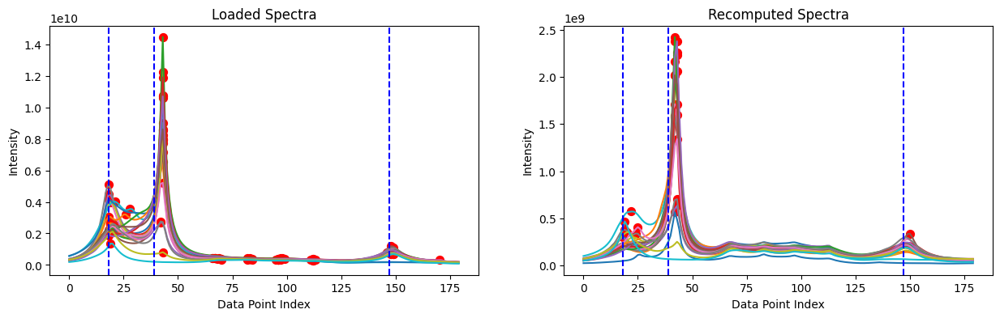

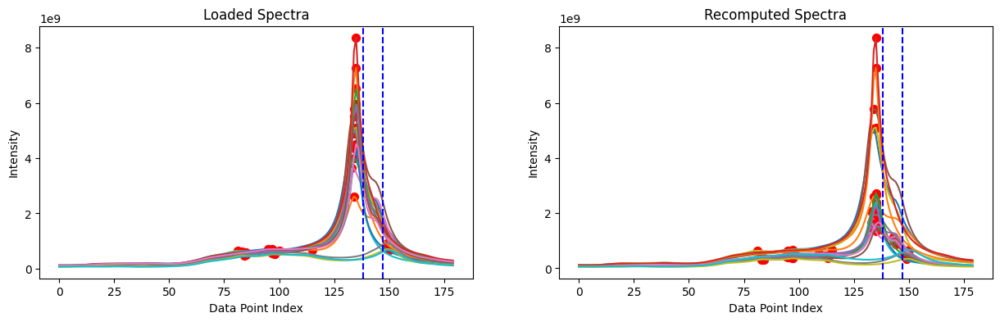

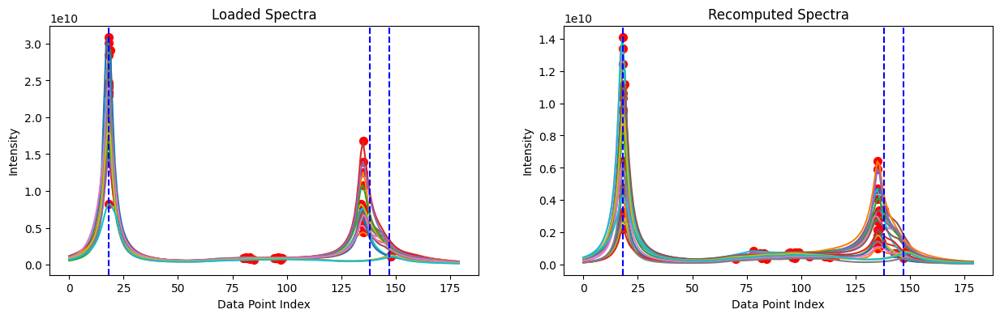

...

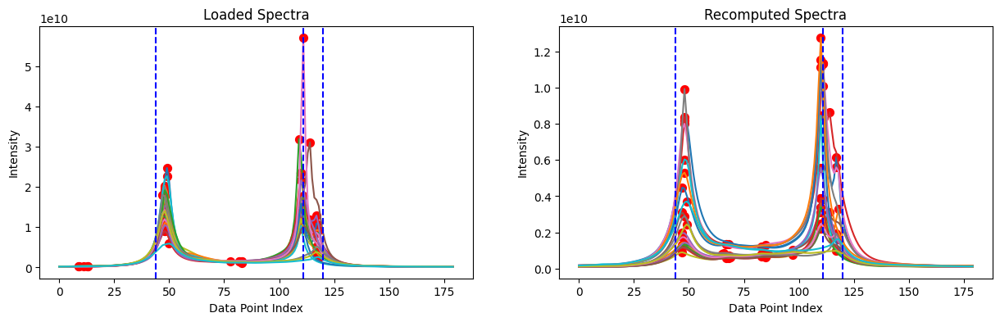

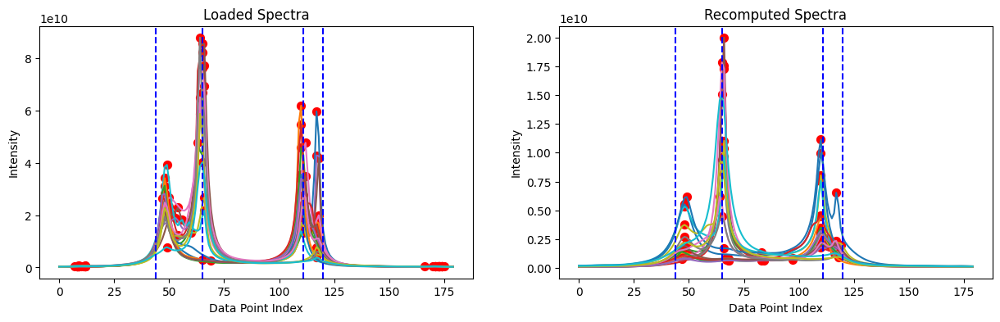

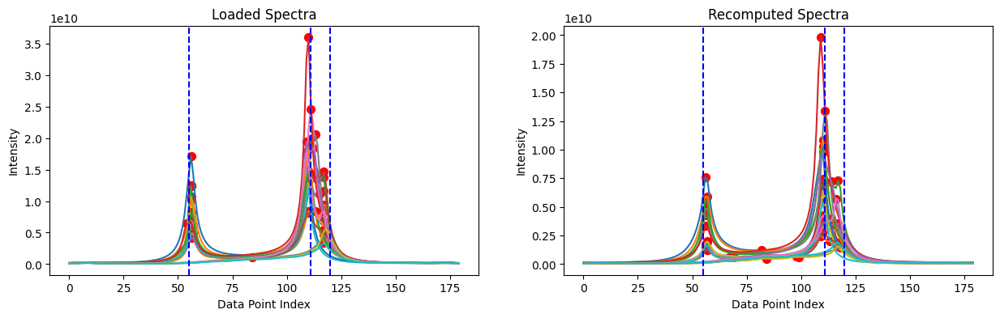

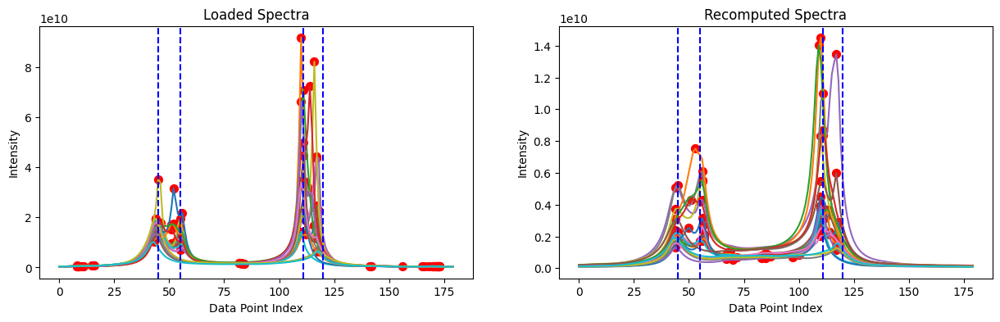

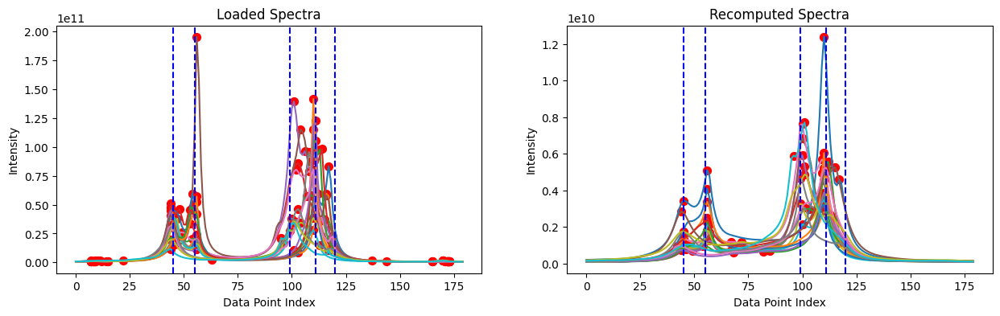

TP_voice: 633, FN_voice: 807, TP_ambient: 363, FN_ambient: 357, FP: 1343


In [27]:
TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

for dir_ref in glob.glob("../experiments/*;*"):
    _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = compare_spectra(dir_ref, method="GEVD_diff_dir", decomposed_coeff=5 * 10 ** 12, thresh=3 * 10 ** 8)
    TP_voice += _TP_voice
    FN_voice += _FN_voice
    TP_ambient += _TP_ambient
    FN_ambient += _FN_ambient
    FP += _FP

print(f"TP_voice: {TP_voice}, FN_voice: {FN_voice}, TP_ambient: {TP_ambient}, FN_ambient: {FN_ambient}, FP: {FP}")

## GEVD diff rev

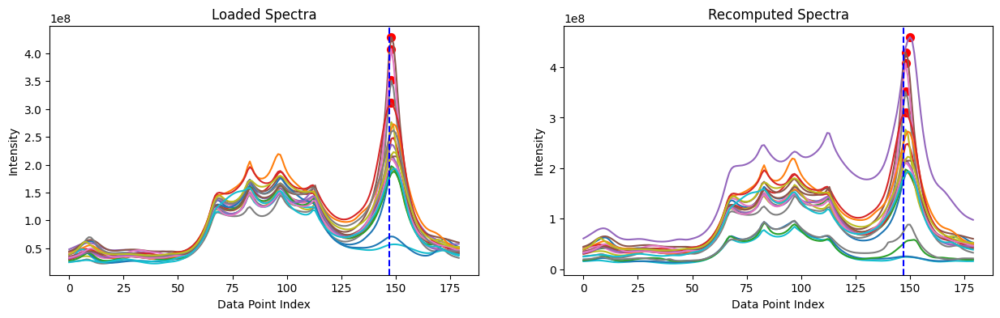

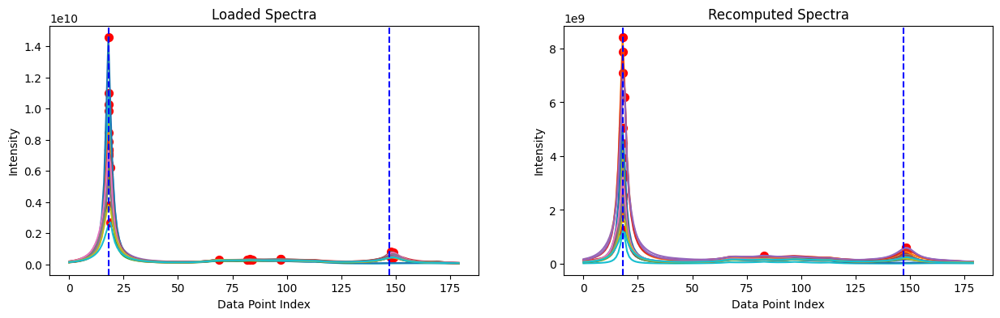

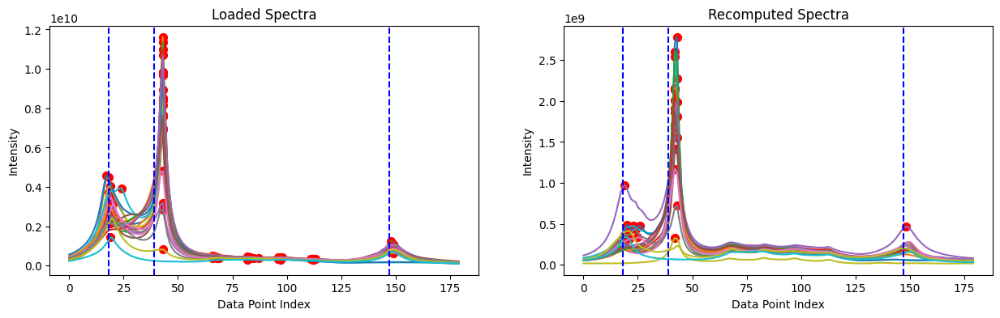

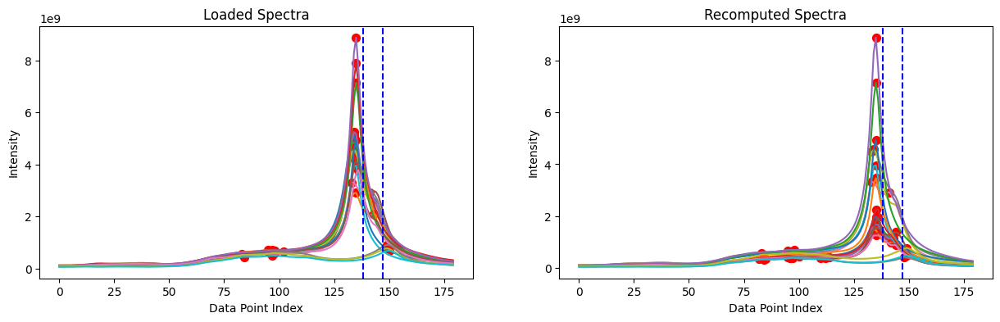

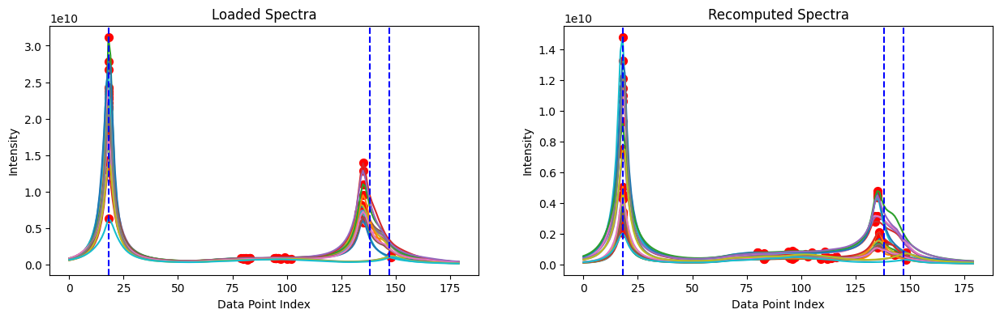

...

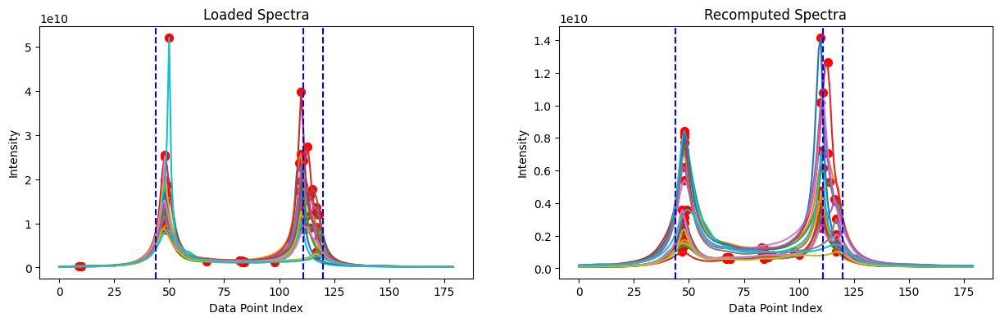

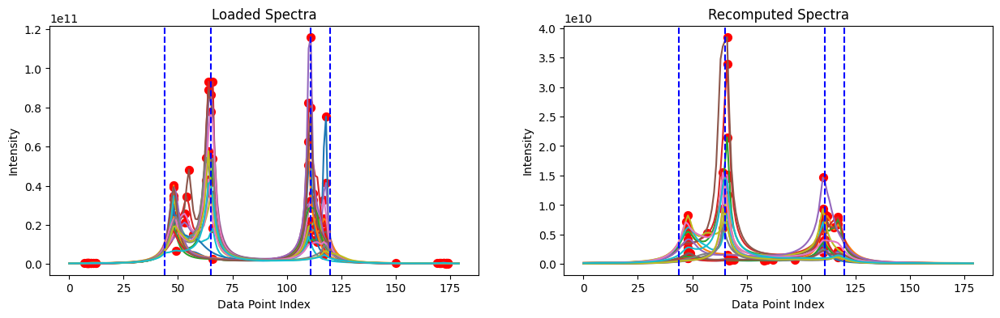

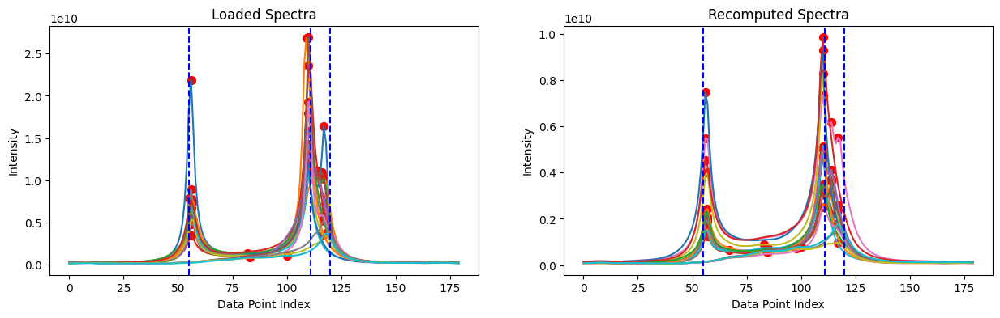

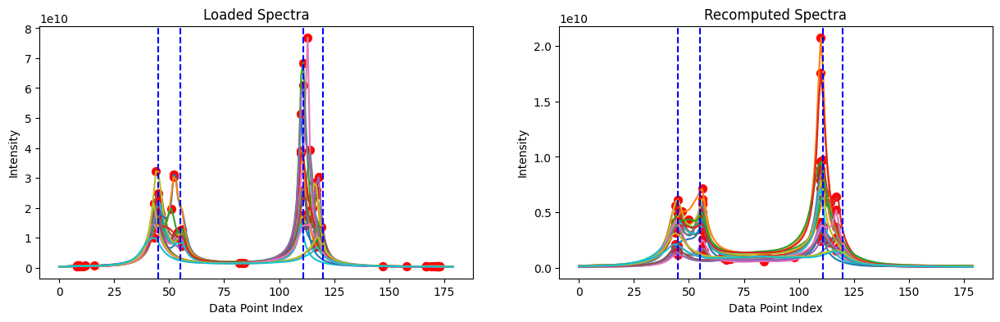

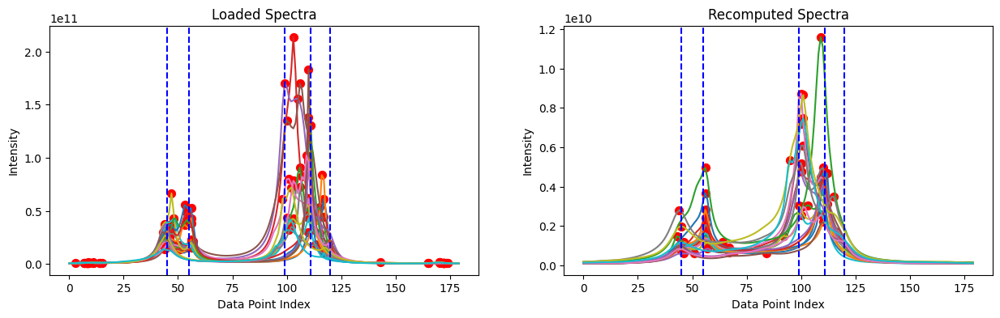

TP_voice: 643, FN_voice: 797, TP_ambient: 363, FN_ambient: 357, FP: 1344


In [28]:
TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

for dir_ref in glob.glob("../experiments/*;*"):
    _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = compare_spectra(dir_ref, method="GEVD_diff_rev", decomposed_coeff=5 * 10 ** 12, thresh=3 * 10 ** 8)
    TP_voice += _TP_voice
    FN_voice += _FN_voice
    TP_ambient += _TP_ambient
    FN_ambient += _FN_ambient
    FP += _FP

print(f"TP_voice: {TP_voice}, FN_voice: {FN_voice}, TP_ambient: {TP_ambient}, FN_ambient: {FN_ambient}, FP: {FP}")

## GEVD stable dir

/tmp/ipykernel_8874/1940531814.py:13: RuntimeWarning: divide by zero encountered in divide
  spatial_spectrum[f, :] = vector_norm_squared / noise_projection


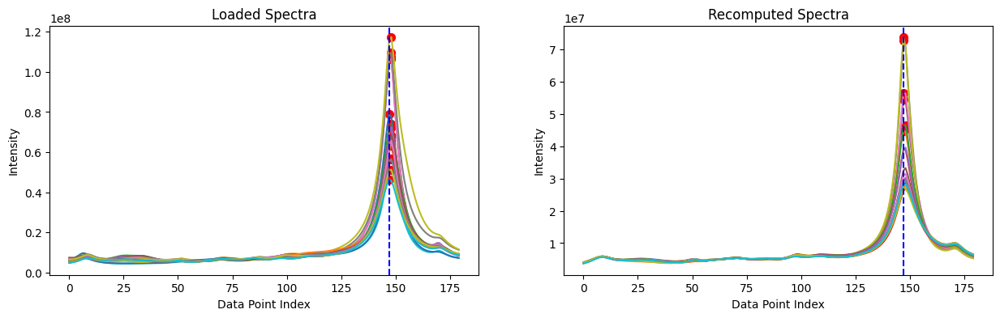

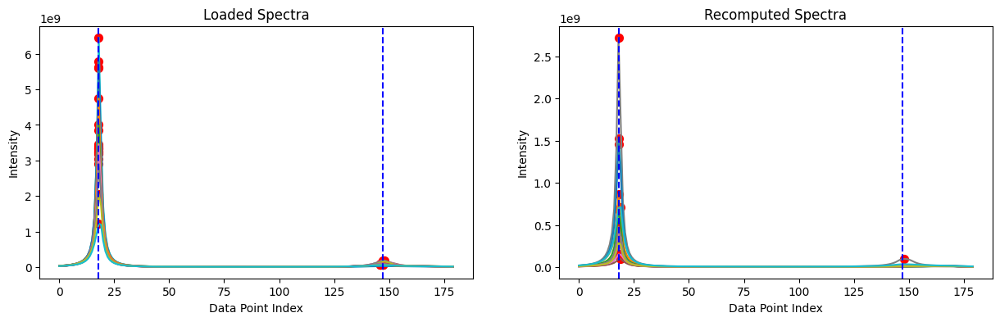

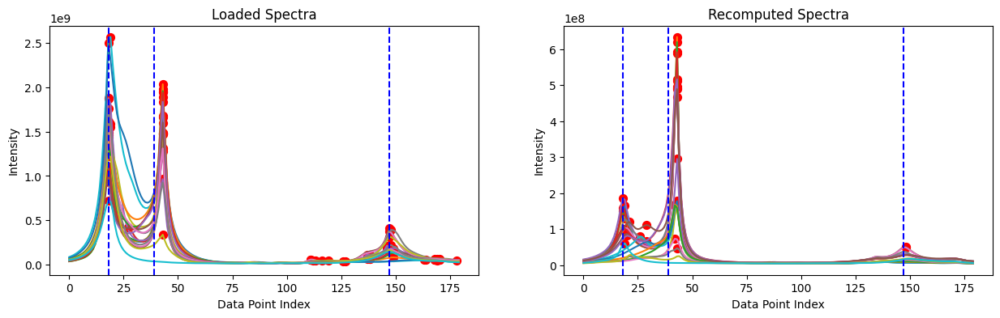

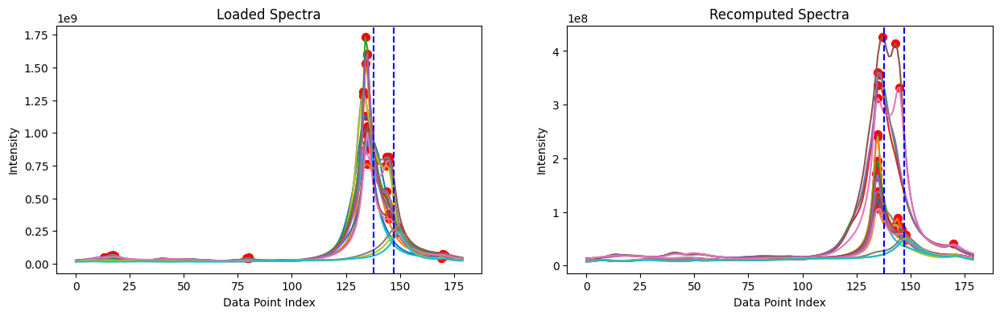

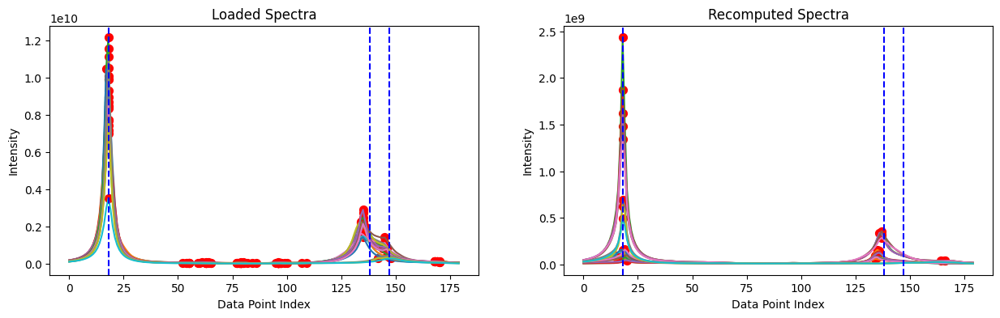

...

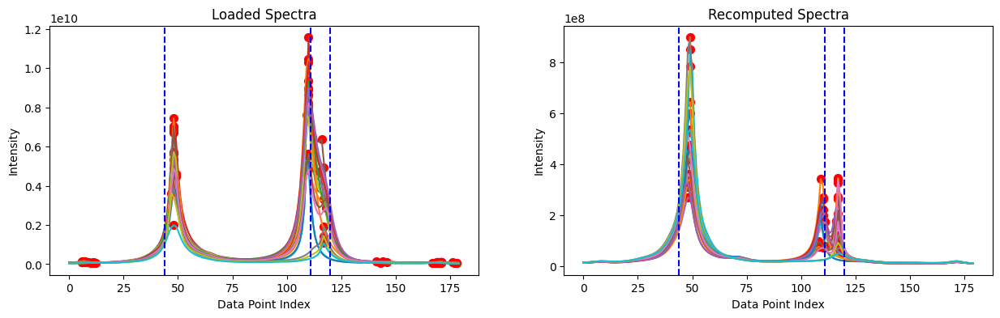

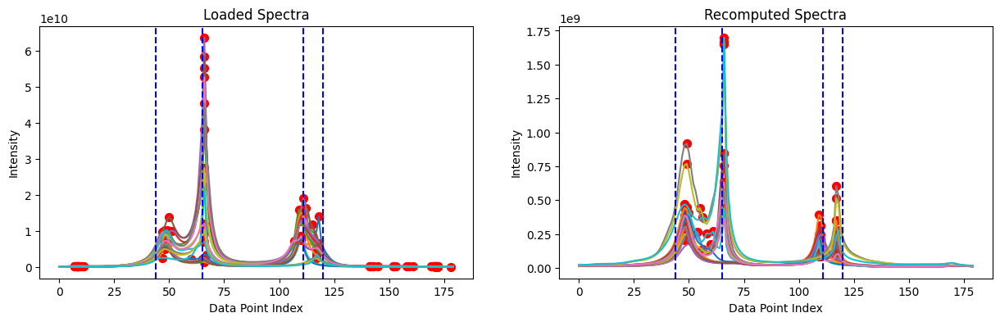

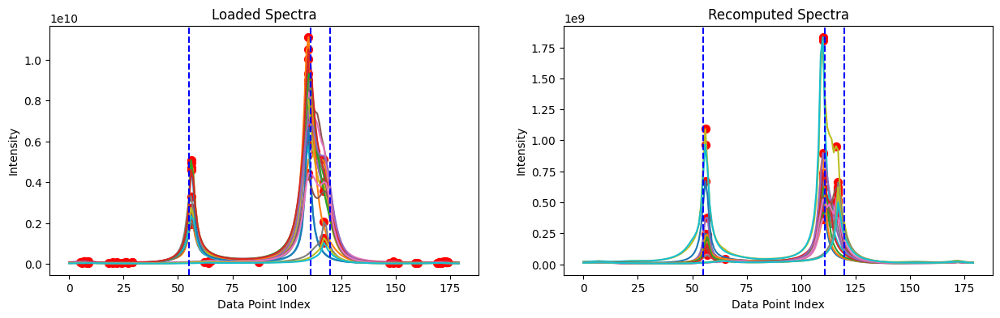

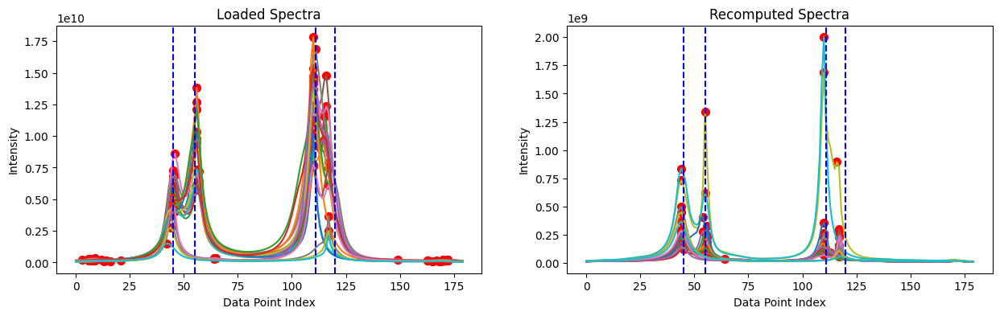

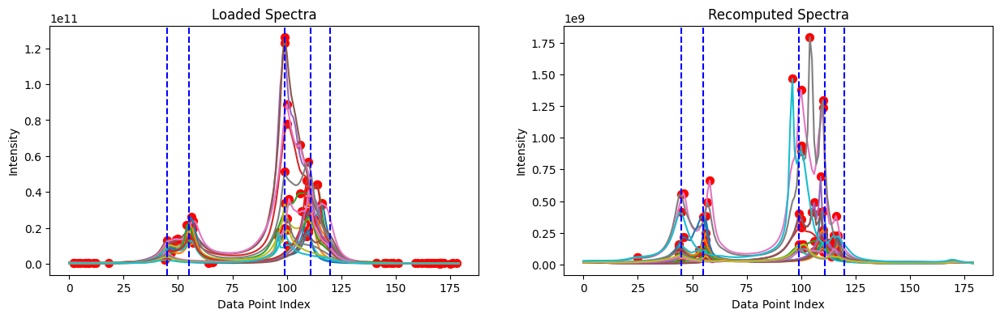

TP_voice: 630, FN_voice: 810, TP_ambient: 310, FN_ambient: 410, FP: 720


In [31]:
TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

for dir_ref in glob.glob("../experiments/*;*"):
    _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = compare_spectra(dir_ref, method="GEVD_stable_dir", decomposed_coeff=4 * 10 ** 3, thresh=4 * 10 ** 7)
    TP_voice += _TP_voice
    FN_voice += _FN_voice
    TP_ambient += _TP_ambient
    FN_ambient += _FN_ambient
    FP += _FP

print(f"TP_voice: {TP_voice}, FN_voice: {FN_voice}, TP_ambient: {TP_ambient}, FN_ambient: {FN_ambient}, FP: {FP}")

## GEVD stable rev

/tmp/ipykernel_8874/1940531814.py:13: RuntimeWarning: divide by zero encountered in divide
  spatial_spectrum[f, :] = vector_norm_squared / noise_projection


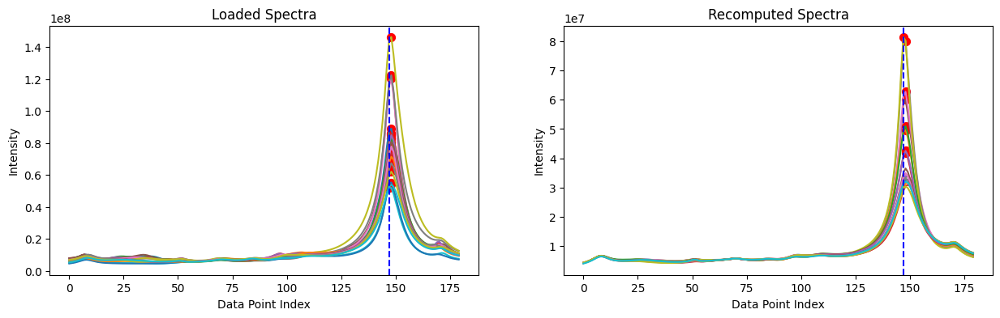

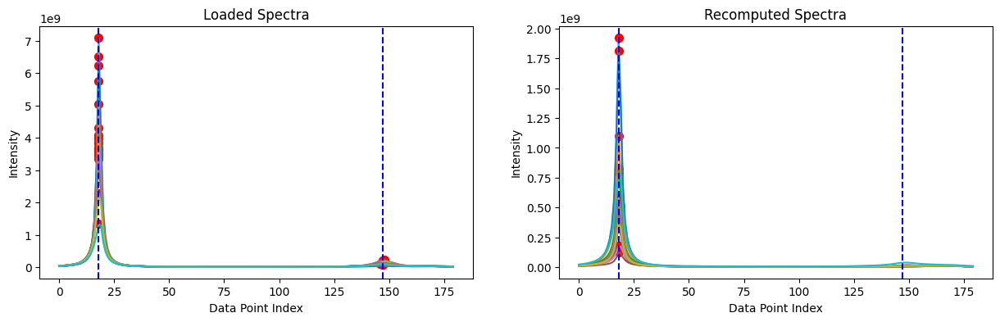

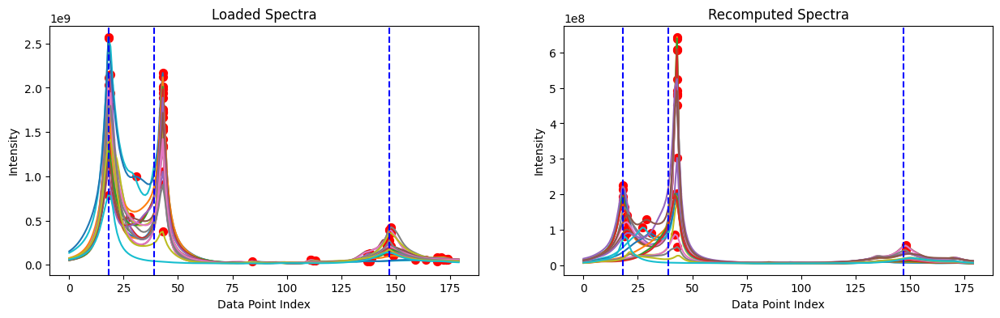

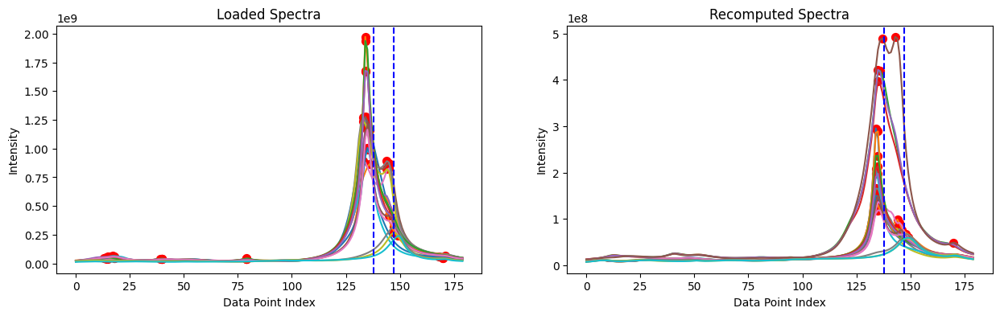

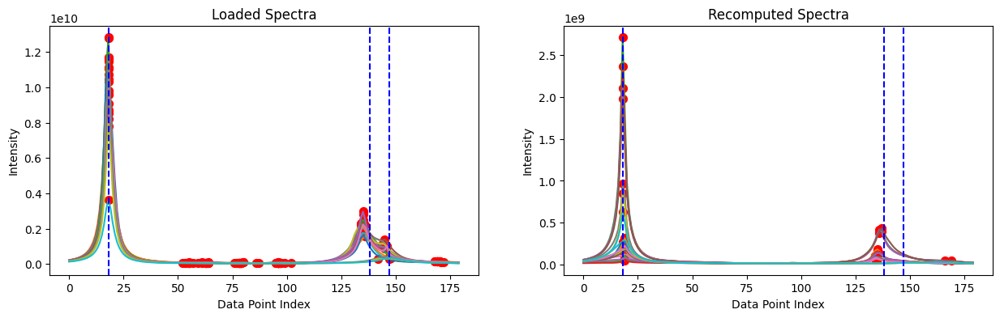

...

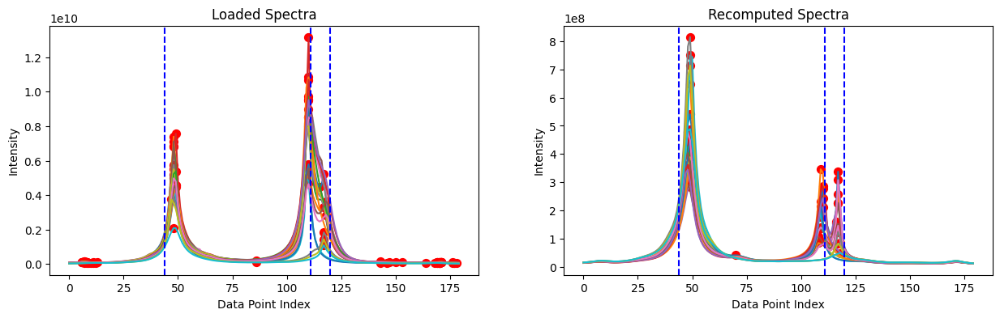

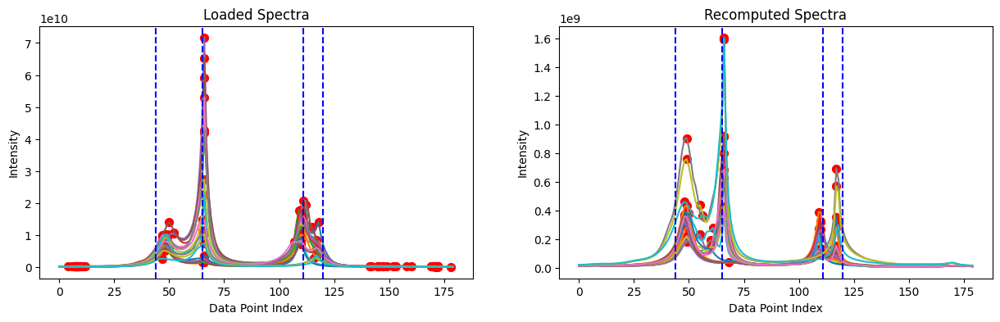

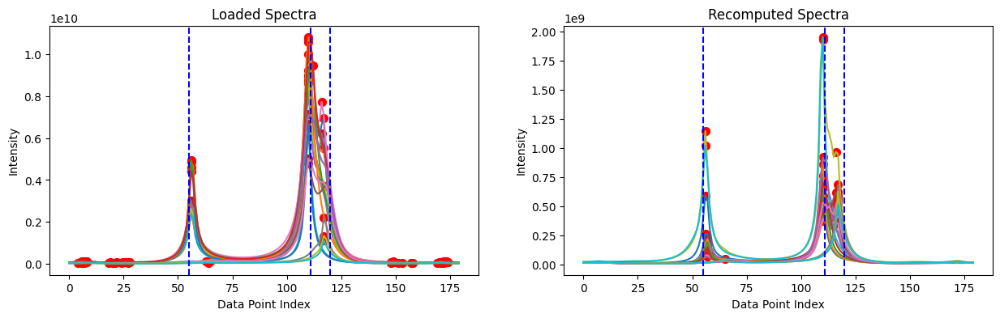

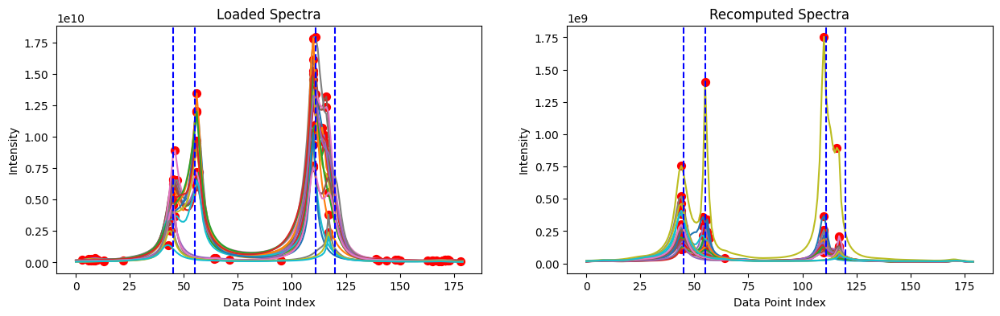

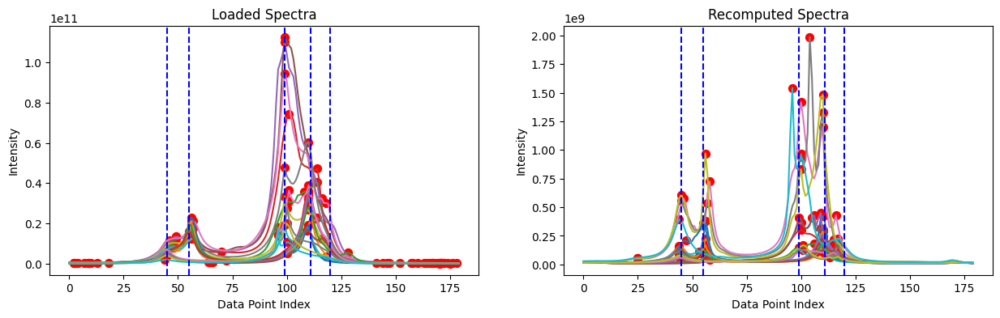

TP_voice: 619, FN_voice: 821, TP_ambient: 315, FN_ambient: 405, FP: 759


In [32]:
TP_voice, FN_voice, TP_ambient, FN_ambient, FP = 0, 0, 0, 0, 0

for dir_ref in glob.glob("../experiments/*;*"):
    _TP_voice, _FN_voice, _TP_ambient, _FN_ambient, _FP = compare_spectra(dir_ref, method="GEVD_stable_rev", decomposed_coeff=4 * 10 ** 3, thresh=4 * 10 ** 7)
    TP_voice += _TP_voice
    FN_voice += _FN_voice
    TP_ambient += _TP_ambient
    FN_ambient += _FN_ambient
    FP += _FP

print(f"TP_voice: {TP_voice}, FN_voice: {FN_voice}, TP_ambient: {TP_ambient}, FN_ambient: {FN_ambient}, FP: {FP}")